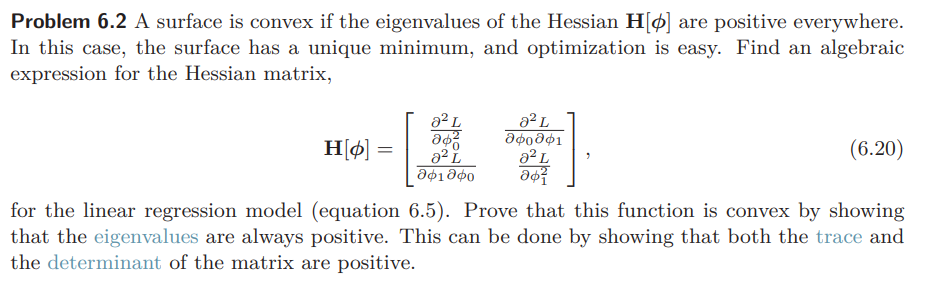

$$L[\phi] = \sum_{i=1}^{I} \ell_i = \sum_{i=1}^{I} (f[x_i, \phi] - y_i)^2 = \sum_{i=1}^{I} (\phi_0 + \phi_1 x_i - y_i)^2$$

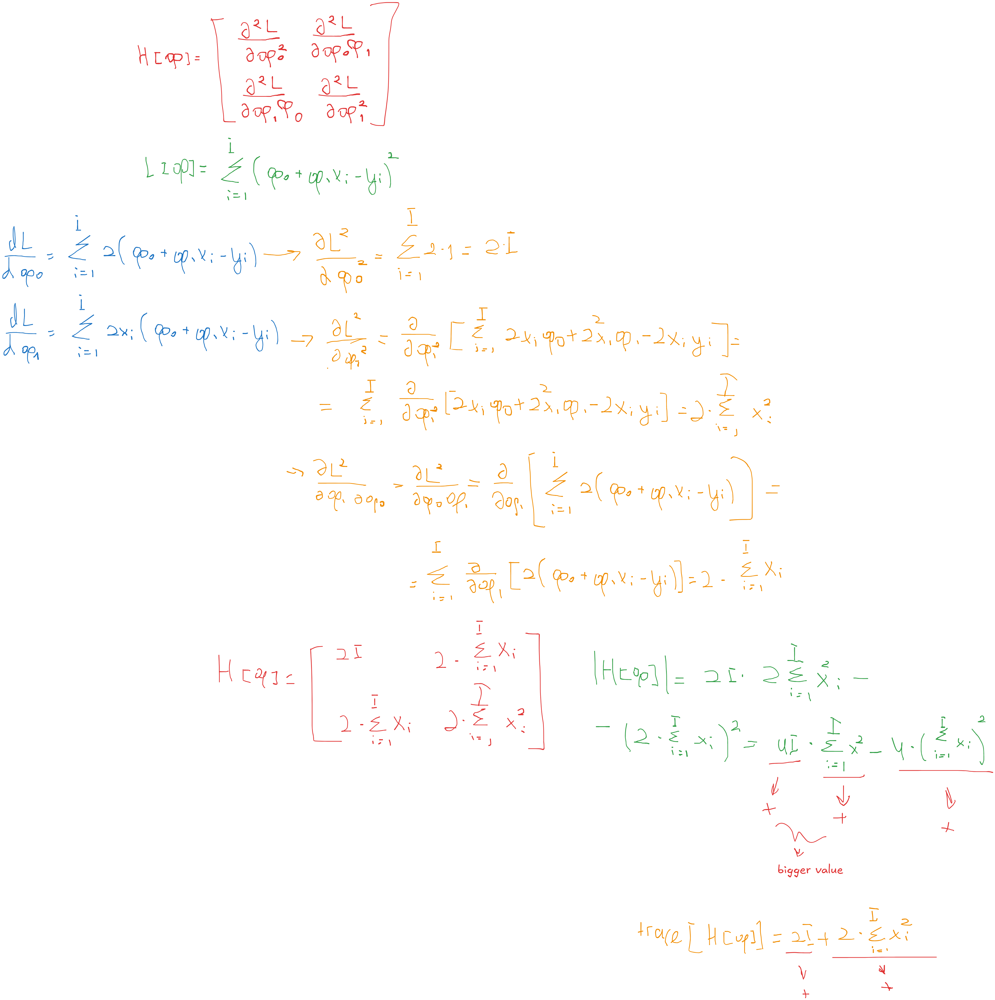

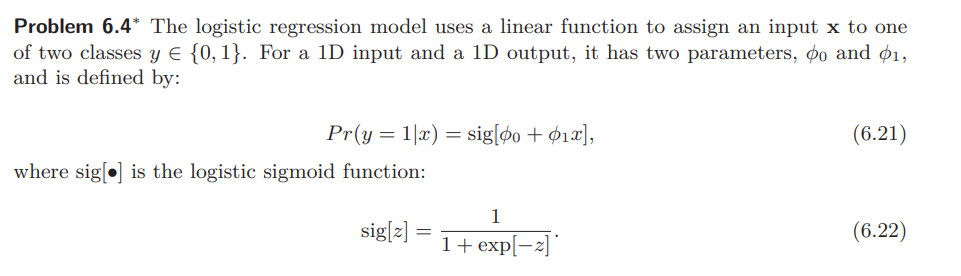
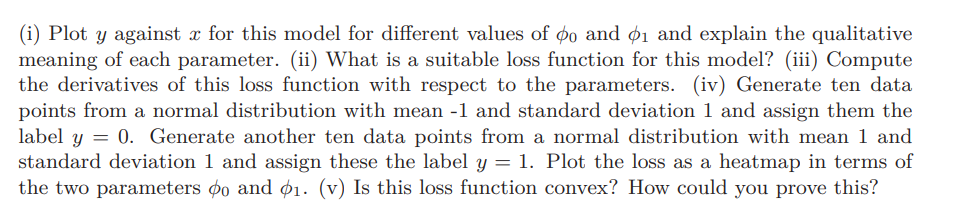

In [59]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

Since we have classification task, as loss we will use negative log-likelihood:
$$L(\phi) = - \sum_{i=1}^{N} \log P(y_i | x_i, \phi)$$
, where
$$P(y_i | x_i, \phi) = (\text{sig}(f[x_i, \phi]))^{y_i} \cdot (1 - \text{sig}(f[x_i, \phi]))^{1 - y_i}$$
, where
$$f[x_i, \phi] = \lambda$$
$$sig(\lambda) = {0, ..., 1}$$

In [62]:
def sigmoid(z):
  return 1 / (1 + np.exp(-z))

In [63]:
def model(X, phi):
  y_pred = phi[0] + phi[1] * X
  return sigmoid(y_pred)

In [64]:
def negative_log_likelihood(y, y_pred):
  return -np.sum(y * np.log(y_pred) + (1 - y) * np.log(1 - y_pred))

Partial derivatives for $L[\phi]$:

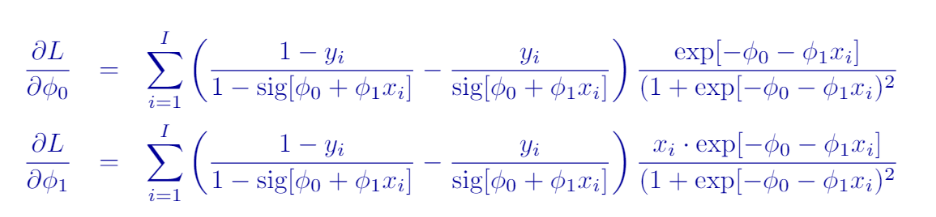

In [81]:
X = np.concatenate([np.random.normal(loc=-1, scale=1, size=10),
              np.random.normal(loc=1, scale=1, size=10)])

y = np.zeros(20)
y[:10] = 0
y[10:] = 1

In [100]:
phi = np.array([-1, 3])
y_pred = model(X, phi)

negative_log_likelihood(y, y_pred)

np.float64(6.50326820315398)

In [93]:
phi_0_vals = np.linspace(-3, 3, 100)
phi_1_vals = np.linspace(-5, 5, 100)

loss_grid = np.zeros((len(phi_0_vals), len(phi_1_vals)))

for i, phi_0 in enumerate(phi_0_vals):
  for j, phi_1 in enumerate(phi_1_vals):
    y_pred = model(X, [phi_0, phi_1])
    loss_grid[i, j] = negative_log_likelihood(y, y_pred)

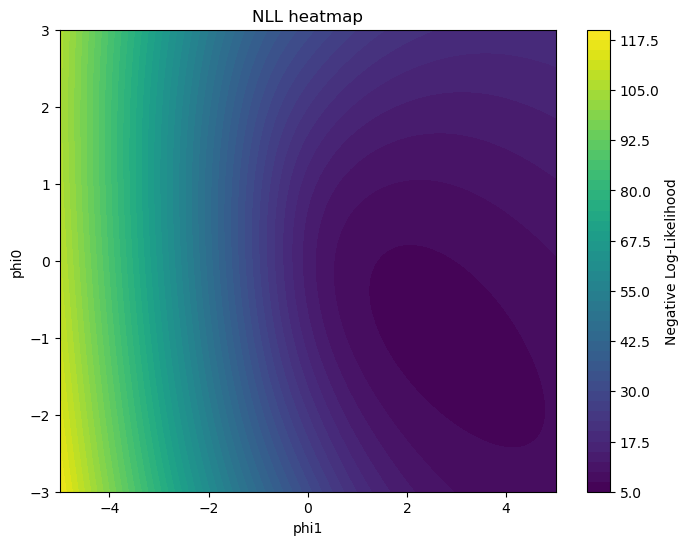

In [102]:
plt.figure(figsize=(8,6))
plt.contourf(phi_1_vals, phi_0_vals, loss_grid, levels=50, cmap='viridis')
plt.xlabel("phi1")
plt.ylabel("phi0")
plt.title("NLL heatmap")
plt.colorbar(label="Negative Log-Likelihood")
plt.show()

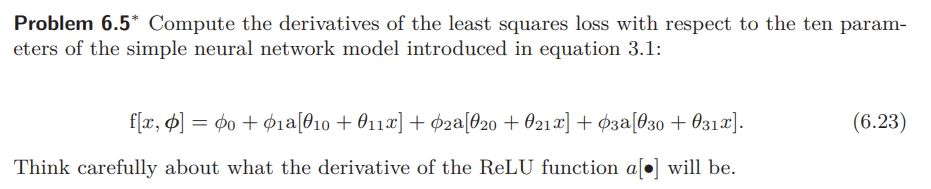

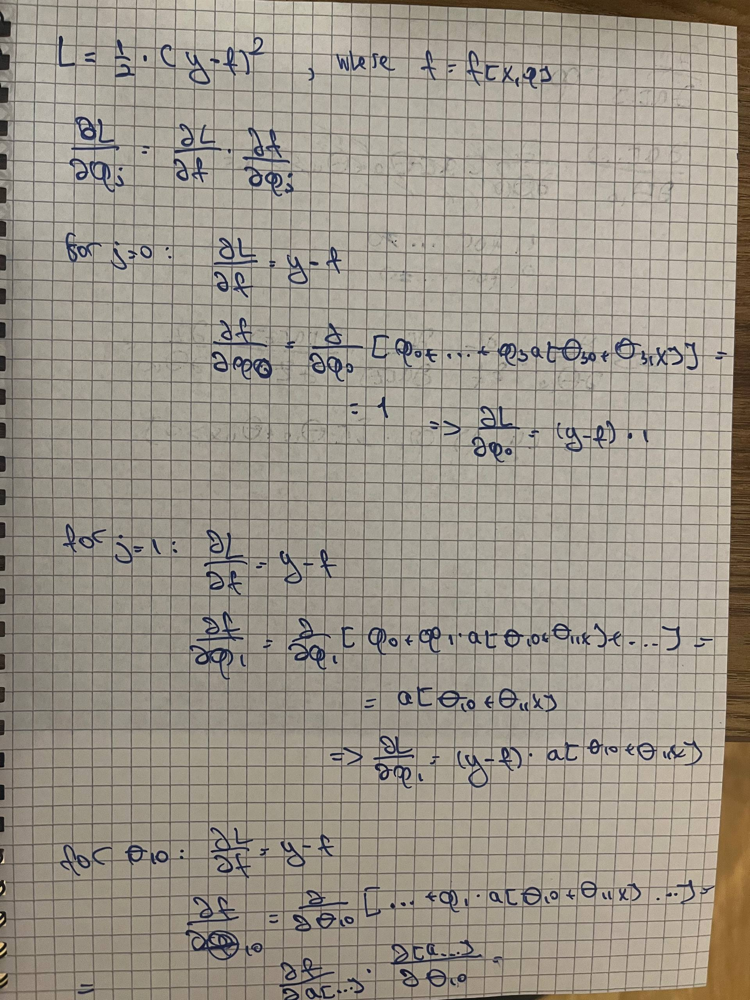
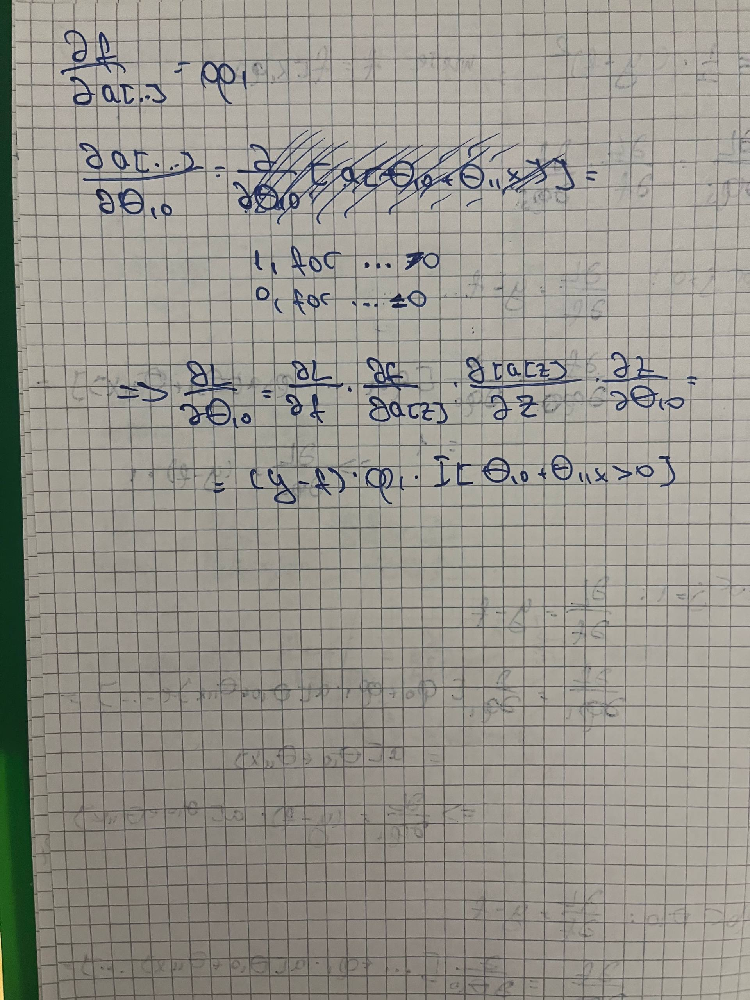

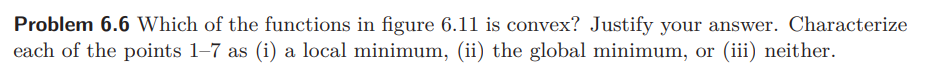

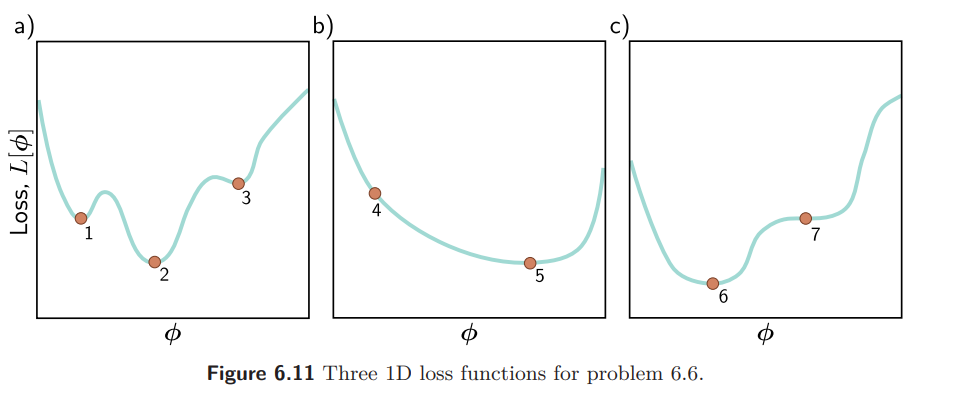

So, function in picture (b) is convex. Why? From picture we can see that it has one global minimum - at point 5 and do not have local minima since slope of the tangent line is zero only at point 5

Lets charactirize points:
- (1): local minimum, since the derivative at that point is zero, and there is global minima at 2
- (2): global minimum since it has slope 0 and no one point is lower placed.
- (3): local minimum, since the derivative at that point is zero, and there is global minima at 2
- (4): neither, it is not local minima since its derivative is non-zero
- (5): global minima
- (6): global minima
- (7): local minima

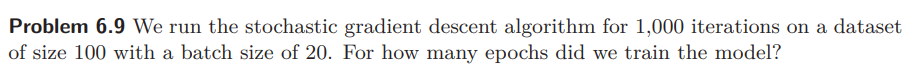

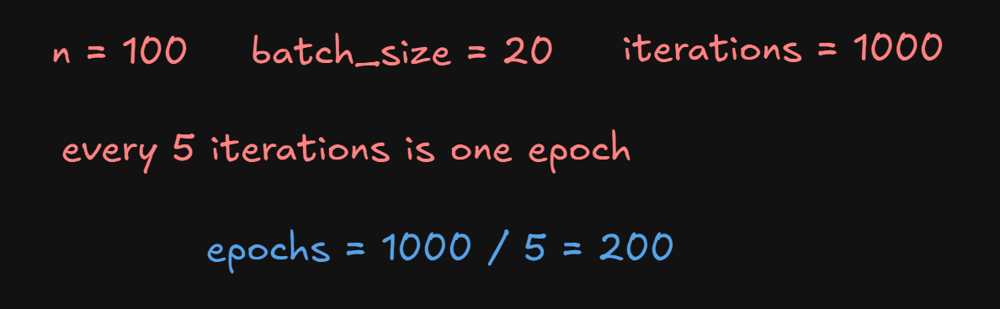

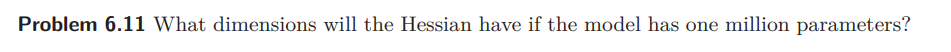

If our model has 2 parameters, suppose $\phi_{0}$ and $\phi_{1}$ - the size of Hessian is 2 x 2,
where diagonal elements - second partial derivatives, and non-diagonal - partial derivatives with respect to one and to other parameter in sequence. If we add one more parameter - the size will be 3 x 3. For one million - 1m x 1m